In [1]:
from image_utils import *
from image_tag_utils import *

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
precision = 0.7
ImgId = 263002
ImgId = 10058
ImgId = 36278
dataset = 'dataset_2'

In [4]:
coco = COCO('../dataset/annotations/instances_train2017.json')

loading annotations into memory...
Done (t=13.01s)
creating index...
index created!


In [5]:
path = "../dataset/images/dataset_2/36278.jpg"
path = "../dataset/images/dataset_2/36278.jpg"
image = Image.open(path)
npimage = np_image(image)

In [6]:
path = "../evaluation/evaluation_images/room_3.jpg"
image = Image.open(path)
npimage = np_image(image)

model, device = init_RNet_model()
boxes_RNet, classes_RNet = predict_RNet(npimage, model, device, precision)
print(boxes_RNet)
print(classes_RNet)

[[  9 170 214 423]
 [328 290 443 424]
 [523 257 634 412]
 [467 269 530 424]
 [ 70  96 116 169]
 [333 249 535 418]]
['refrigerator', 'chair', 'chair', 'chair', 'vase', 'dining table']


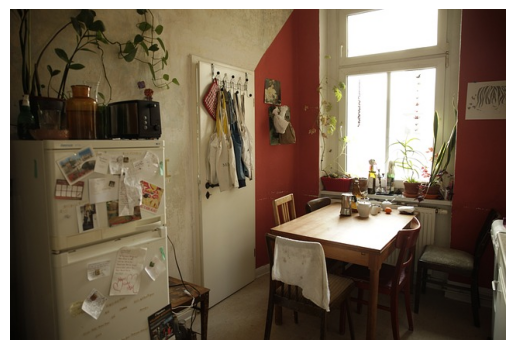

In [8]:
draw_boxes(image, [], [], 'r', 0.5)

# Retina Net

In [7]:
model, device = init_RNet_model()
boxes_RNet, classes_RNet = predict_RNet(npimage, model, device, precision)

In [8]:
print(boxes_RNet)
print(classes_RNet)

[[  9 170 214 423]
 [328 290 443 424]
 [523 257 634 412]
 [467 269 530 424]
 [ 70  96 116 169]
 [333 249 535 418]]
['refrigerator', 'chair', 'chair', 'chair', 'vase', 'dining table']


# YOLO

In [9]:
net = init_YOLO_model()
boxes_YOLO, classes_YOLO = predict_YOLO(npimage, net, precision)

In [10]:
print(boxes_YOLO)
print(classes_YOLO)

[[4, 167, 219, 411], [328, 293, 437, 419], [333, 247, 536, 423], [383, 243, 413, 261], [519, 254, 628, 396], [72, 98, 110, 168]]
['refrigerator', 'chair', 'dining table', 'chair', 'chair', 'bottle']


# General

In [12]:
ids = [int(x[:-4]) for x in get_images_files(dataset)]
annIds = coco.getAnnIds(imgIds=ids, iscrowd=None)
imgsAnns = coco.loadAnns(annIds)

boxes_ann, classes_ann = get_ann_tags(ImgId, imgsAnns)

In [13]:
print(boxes_ann)
print(classes_ann)

[[436.52, 249.05, 476.07, 291.53000000000003], [540.8, 253.87, 622.55, 391.89], [447.05, 283.92, 640.0, 421.24], [428.31, 261.09, 542.25, 425.81999999999994], [400.98, 254.24, 415.12, 302.15], [93.63, 260.22, 176.23, 360.26000000000005], [92.86, 212.59, 166.57, 260.45], [1.7, 23.23, 28.36, 426.0], [532.88, 274.12, 551.4, 302.95], [552.04, 273.56, 640.0, 369.85], [401.47, 253.82, 415.59000000000003, 301.32]]
['chair', 'chair', 'dining table', 'chair', 'chair', 'oven', 'oven', 'refrigerator', 'vase', 'chair', 'couch']


In [14]:
b = box_sizes(boxes_ann)
print(b)

[0.01844035147598536, 0.12384200739426833, 0.29081498188807897, 0.2060094355394939, 0.00743556165197241, 0.09069679260853365, 0.03872017434076685, 0.11785702078216126, 0.005860353630018025, 0.09296181749308163, 0.007361503195639847]


In [16]:
b[5]+b[6]

0.1294169669493005

# Obteining the most similar images

###  For every combination of model and similarity

Image to compare:


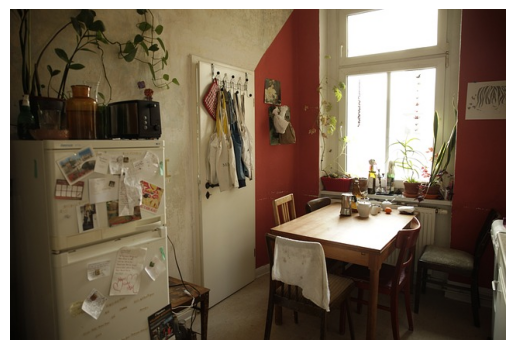

Similar images:


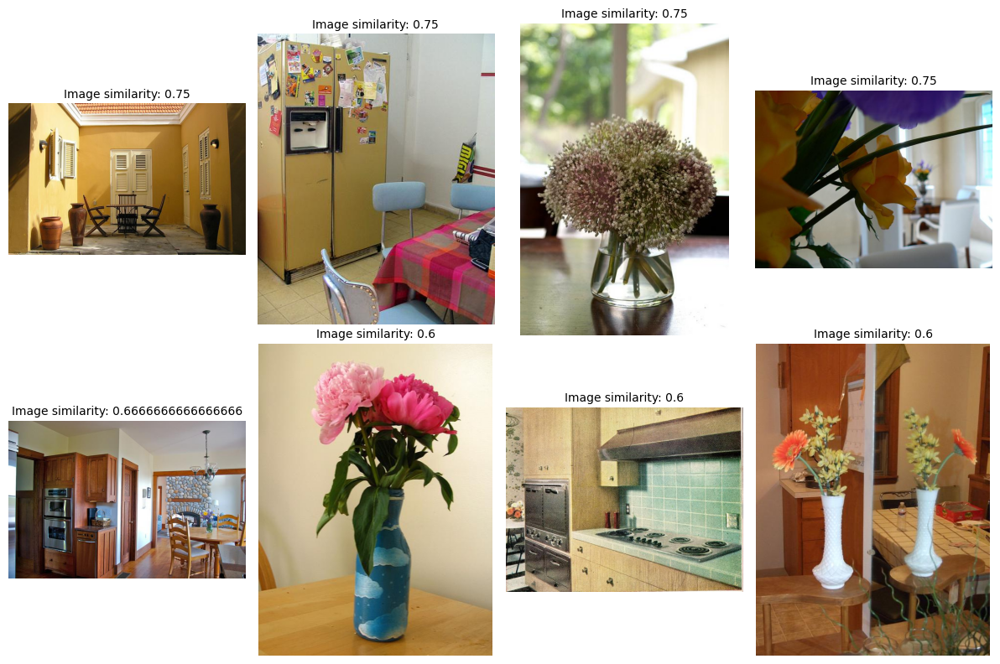

In [12]:
df_scores = calculate_similarity(image, 'tags', 'set', coco, dataset, 'RNet|0.7|0.5')
top_similar(image, df_scores, dataset, ascending = False, top = 8)

In [13]:
df_scores

,ids,sim
3185,514424,0.750000
3759,211302,0.750000
4947,231744,0.750000
3062,458802,0.750000
3534,36278,0.666667
...,...,...
1851,545526,0.000000
1852,350028,0.000000
1853,475037,0.000000
1854,333613,0.000000


-- Model: RNet | Similarity: set -----------------------------------------------------------------------------------------------------------
Image to compare:


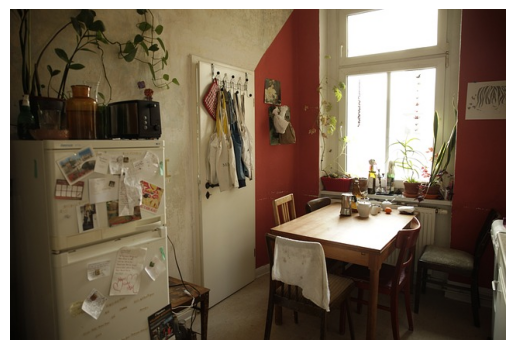

Similar images:


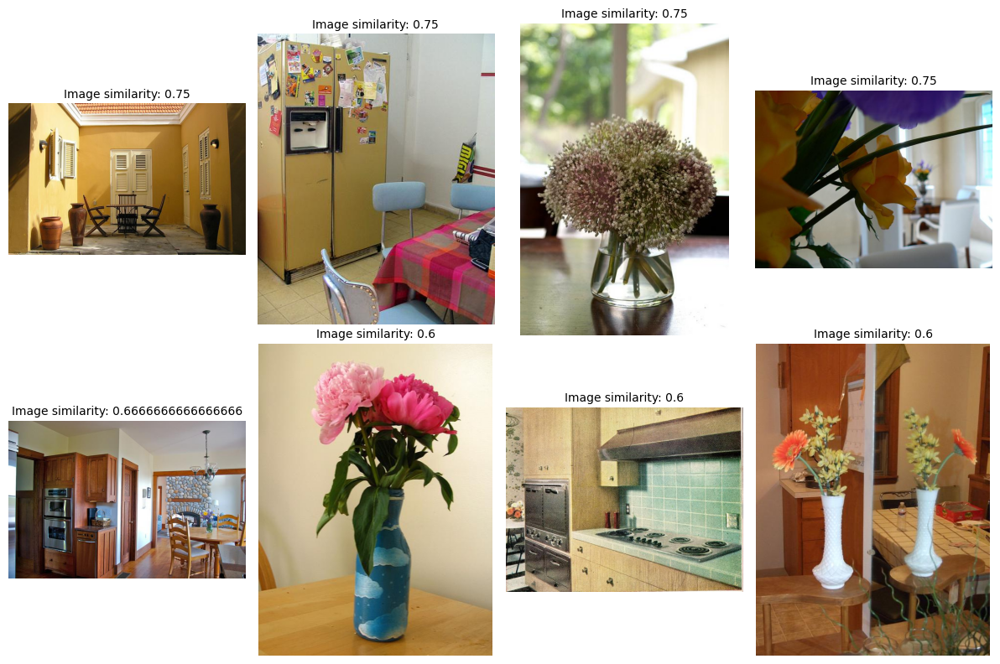

-- Model: RNet | Similarity: set_s -----------------------------------------------------------------------------------------------------------
Image to compare:


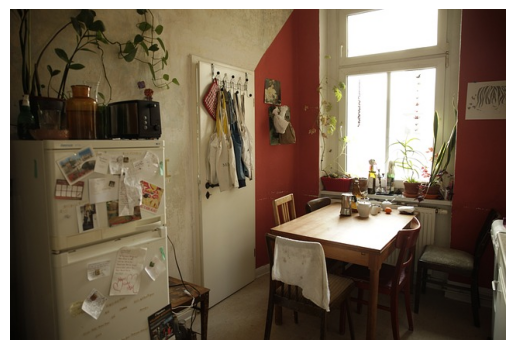

Similar images:


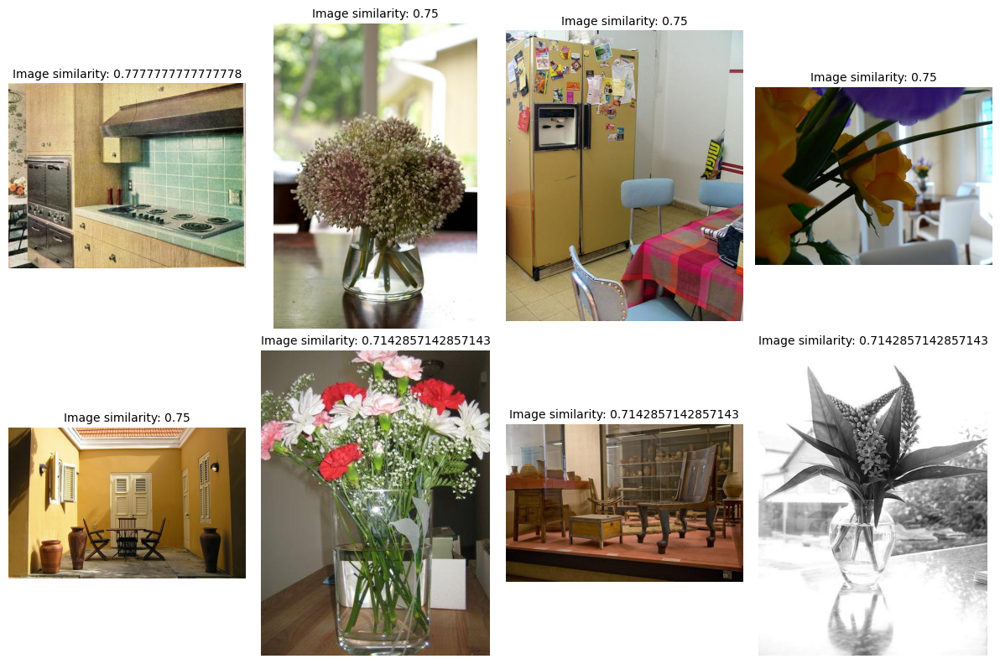

-- Model: RNet | Similarity: multiset -----------------------------------------------------------------------------------------------------------
Image to compare:


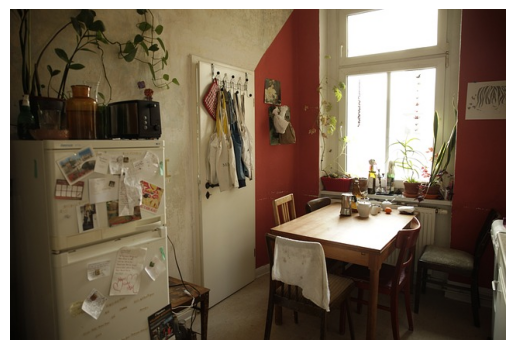

Similar images:


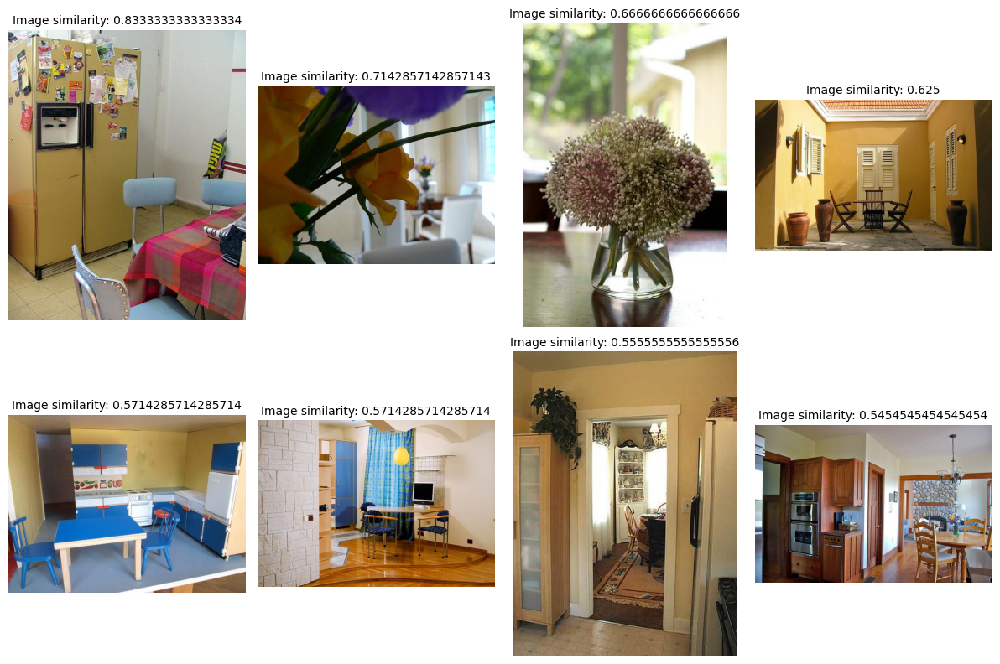

-- Model: RNet | Similarity: multiset_s -----------------------------------------------------------------------------------------------------------
Image to compare:


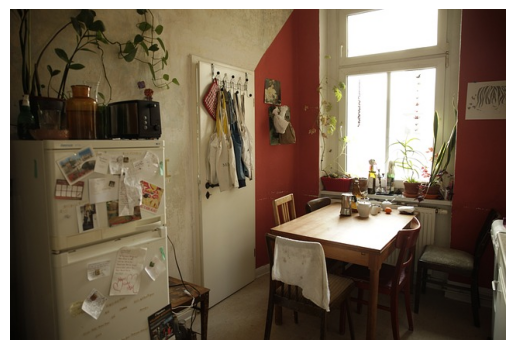

Similar images:


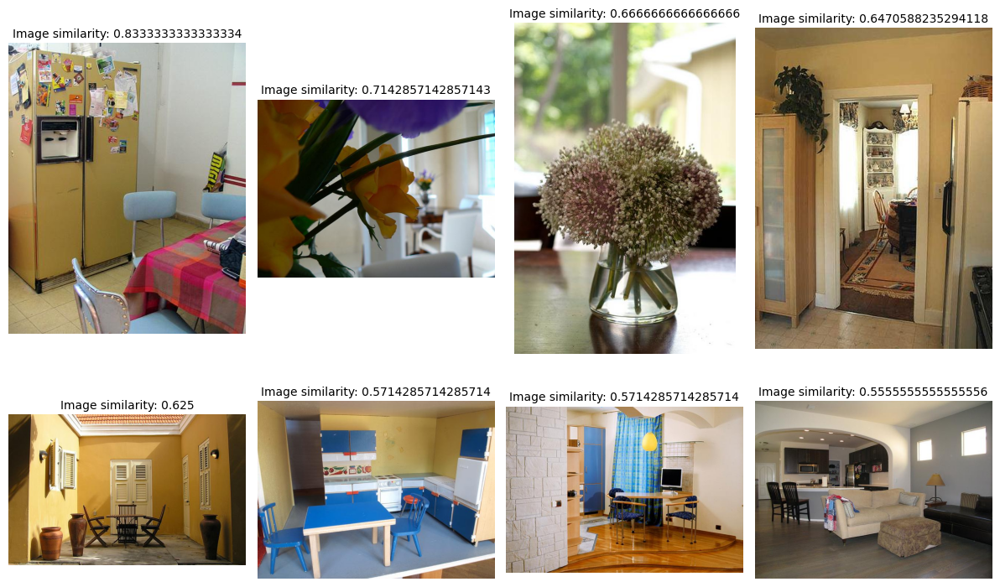

-- Model: RNet | Similarity: size_set -----------------------------------------------------------------------------------------------------------
Image to compare:


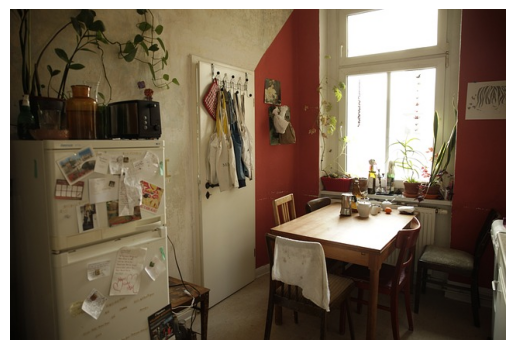

Similar images:


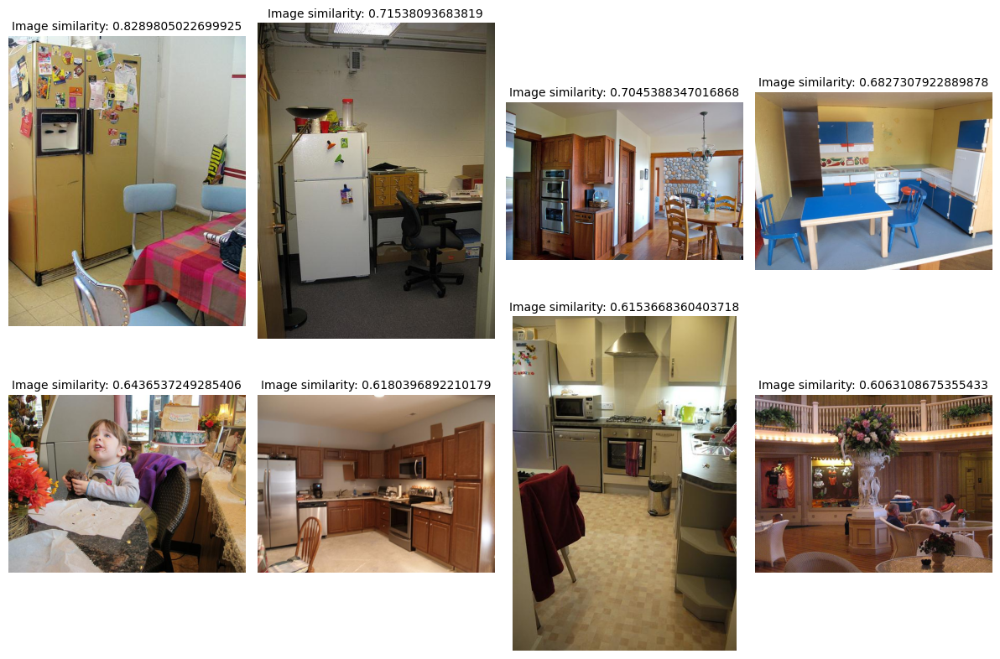

-- Model: RNet | Similarity: size_set_s -----------------------------------------------------------------------------------------------------------
Image to compare:


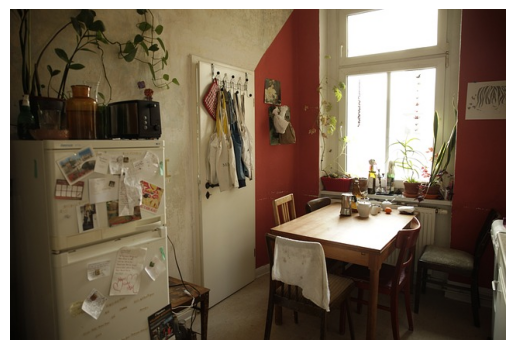

Similar images:


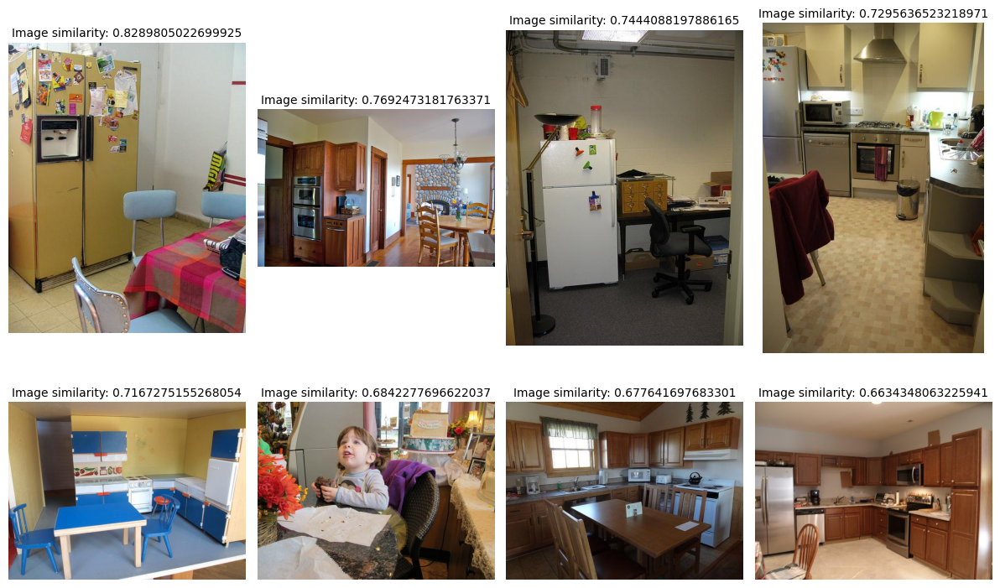

-- Model: YOLO | Similarity: set -----------------------------------------------------------------------------------------------------------
Image to compare:


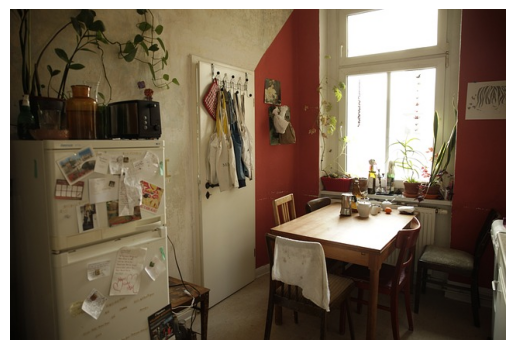

Similar images:


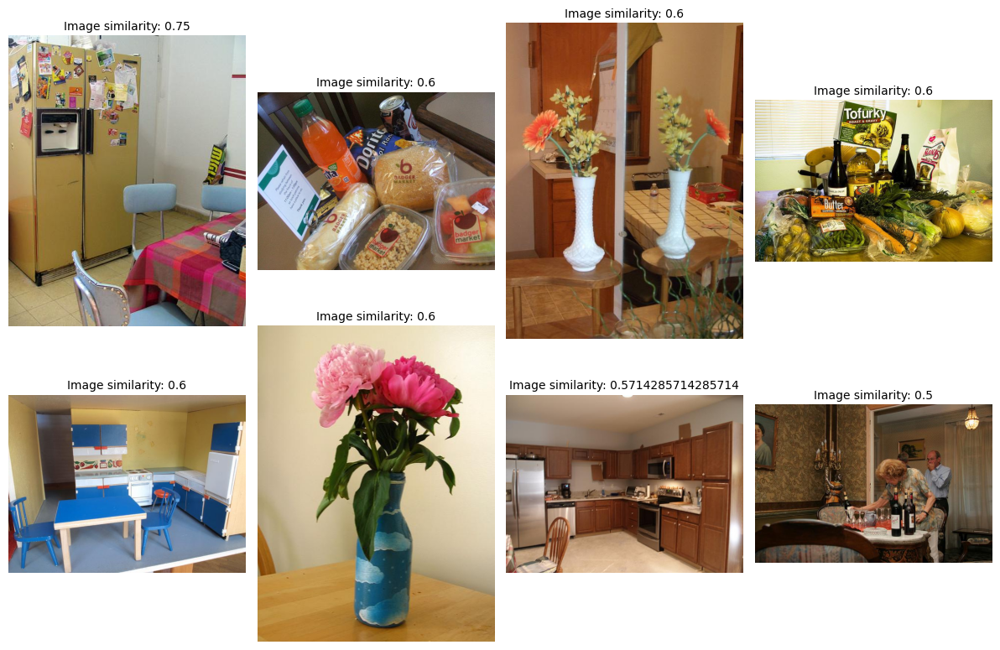

-- Model: YOLO | Similarity: set_s -----------------------------------------------------------------------------------------------------------
Image to compare:


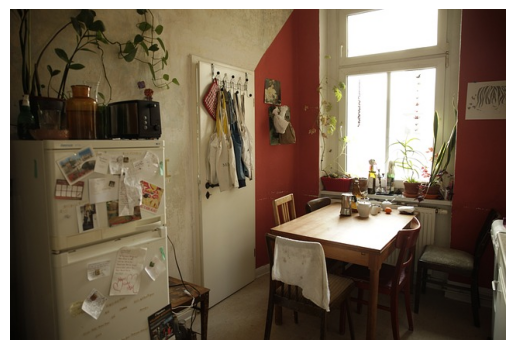

Similar images:


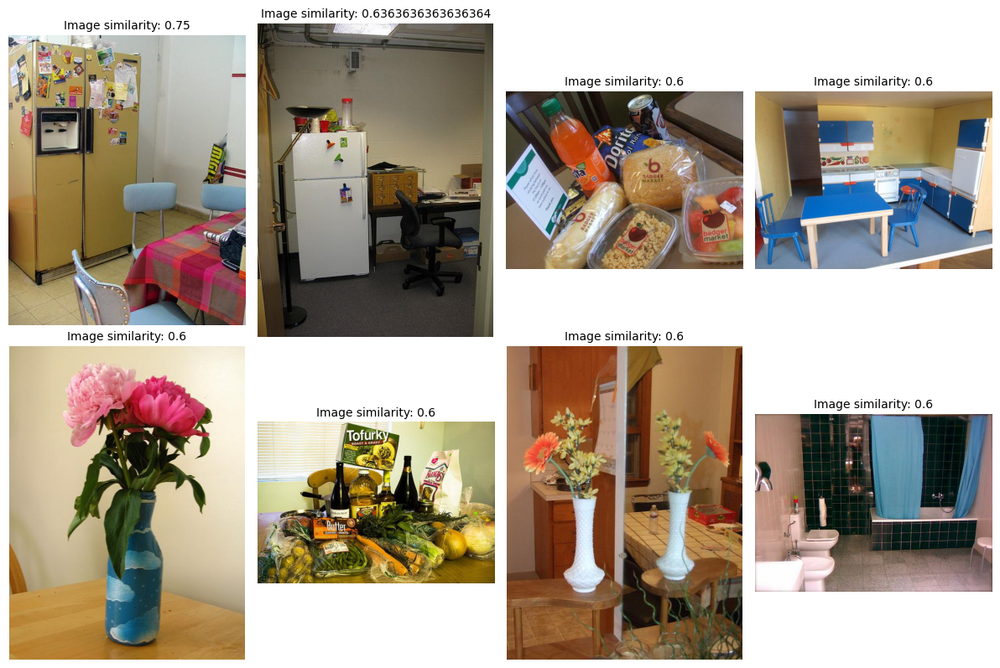

-- Model: YOLO | Similarity: multiset -----------------------------------------------------------------------------------------------------------
Image to compare:


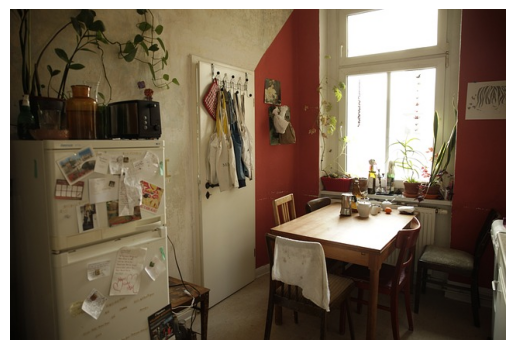

Similar images:


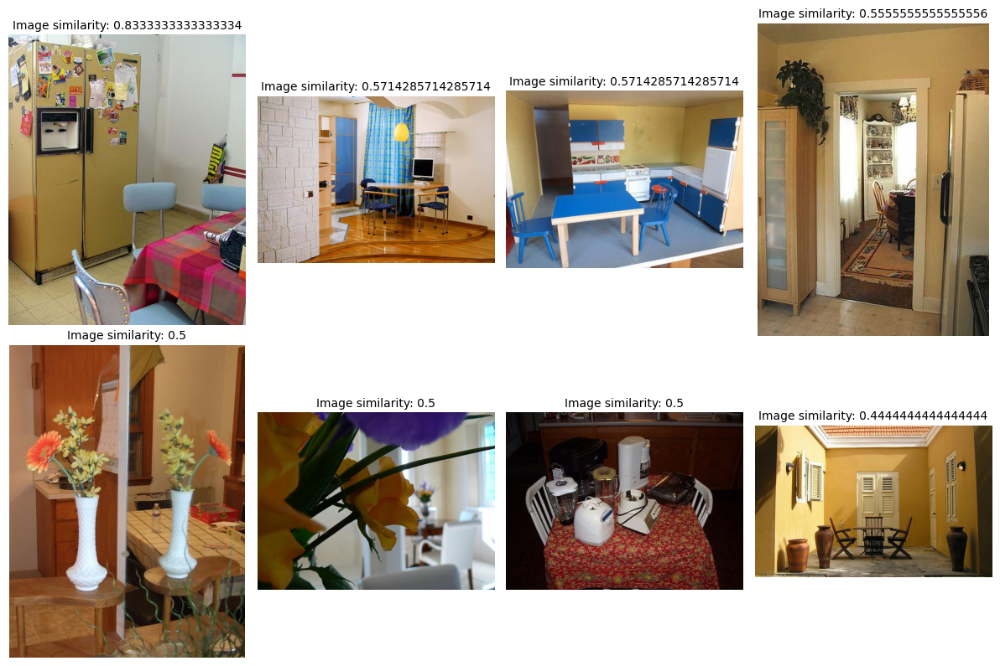

-- Model: YOLO | Similarity: multiset_s -----------------------------------------------------------------------------------------------------------
Image to compare:


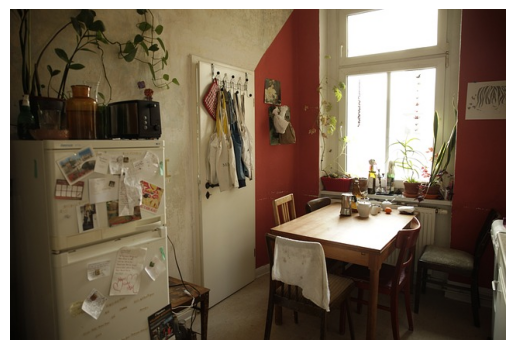

Similar images:


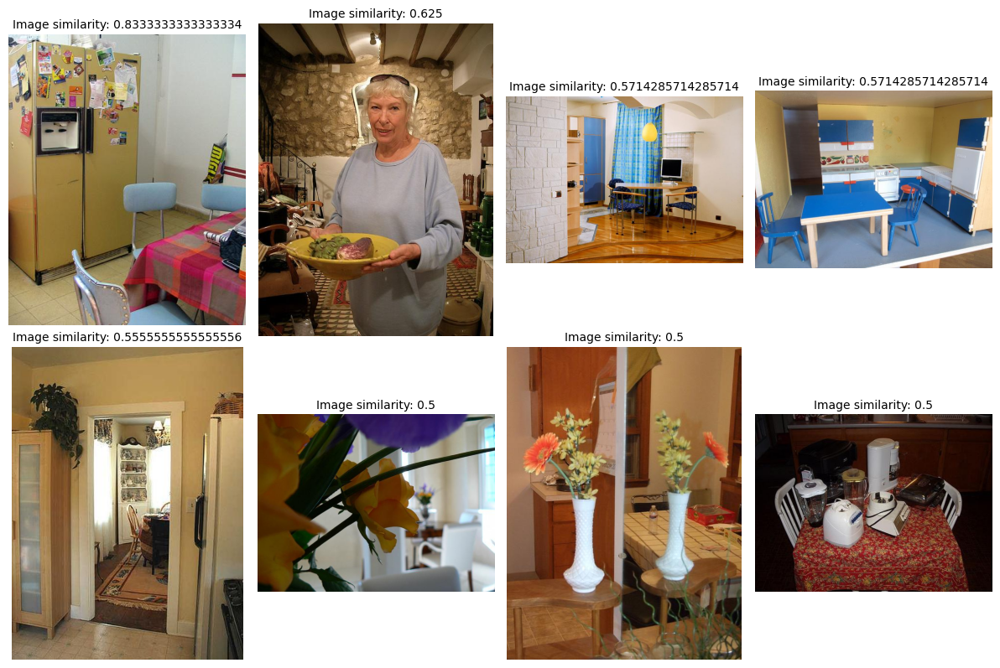

-- Model: YOLO | Similarity: size_set -----------------------------------------------------------------------------------------------------------
Image to compare:


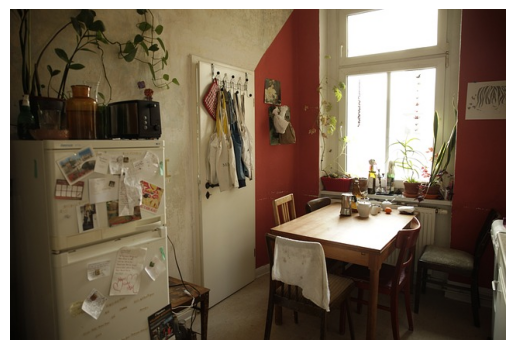

Similar images:


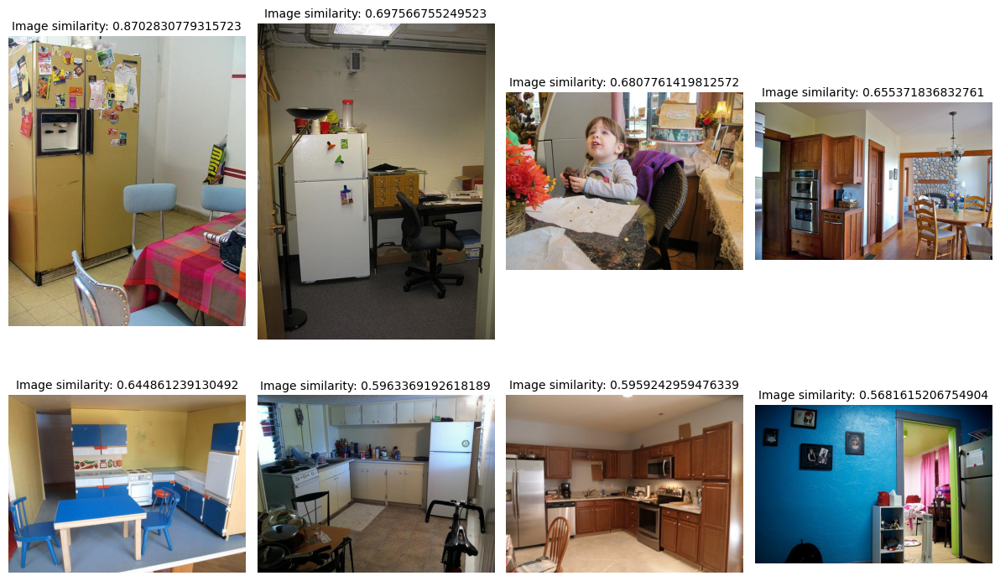

-- Model: YOLO | Similarity: size_set_s -----------------------------------------------------------------------------------------------------------
Image to compare:


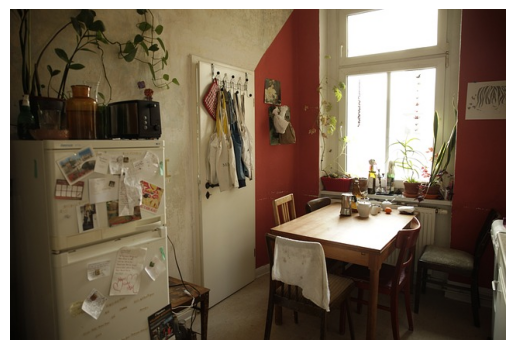

Similar images:


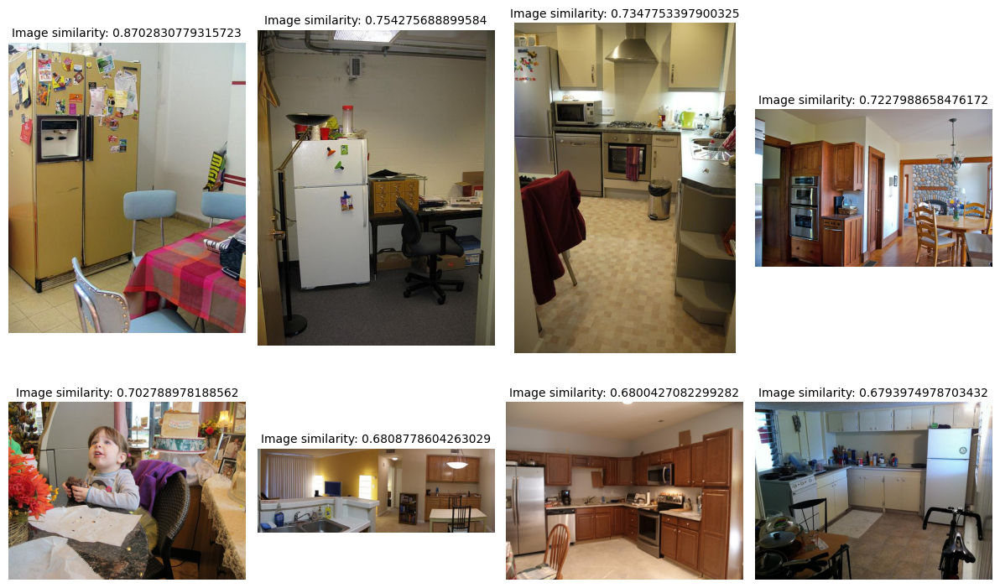

In [9]:
for model in ['RNet', 'YOLO']:
    for sim in ['set', 'set_s', 'multiset', 'multiset_s', 'size_set', 'size_set_s']:
        print('-- Model: '+ model+ ' | Similarity: '+sim+' -----------------------------------------------------------------------------------------------------------')
        df_scores = calculate_similarity(image, 'tags', sim, coco, dataset, model+'|0.7|0.5')
        top_similar(image, df_scores, dataset, ascending = False, top = 8)